# Public Space Arrest Data
This notebook includes an exploration of arrest data in the City of LA between 2010 and 2019. Exploring this data is a first step for our project examining the reclamation of public space and neighborhood change/gentrification. In this notebook I completed an initial exploration of the arrest data within six of the neighborhoods we are investigating for our project. 

We selected six neighborhoods (Boyle Heights, Lincoln Heights, Fairfax, Jefferson Park, Los Feliz, and Westlake. We wanted to explore different stages of gentrification and the trends of arrests related to the "unsanctioned" use of public space. So we picked two neighborhoods that fall into three different stages of gentrification as follows: 

- At risk = Westlake & Boyle heights 

- Gentrifying = Lincoln Heights & Jefferson Park

- Exclusionary = Los Feliz & Fairfax 

In this notebook we preformed the following tasks to explore the arrest trends in these six neighborhoods:
- Filtered the arrest data (2010-2019) to include arrest types we determined were related to "unsanctioned" use of public space
- Filtered the data to just include these arrests in Boyle Heights, Lincoln Heights, Fairfax, Jefferson Park, Los Feliz, and Westlake
- Visualized the arrests in those six neighborhoods by year between 2010 and 2019 
- Mapped the arrests by charge description
- Mapped the arrest data by charge description overlayed with the LA Parks

In [1]:
#imported the librarys needed
import pandas as pd
import geopandas as gpd

import json

import plotly.express as px
import plotly.graph_objs as go

import requests

## PART 1 – Filtered, Cleaned, and Visualized the Citywide Arrest Data

### Created a list of arrest types related to "unsanctioned use" of public space

In [2]:
arrest_types = ["OPEN ALCOHOLIC BEV IN PUBLIC PARK/PLACE", 
                "PLAY BALL/GAMES IN STREET OR PARK", 
                "RECKLESS DRIVING", 
                "IMPEDING NORMAL FLOW OF TRAFFIC", 
                "ILLEGAL STREET/SIDEWALK SALES", 
                "ILLEGAL SALES - FREEWAY RAMPS",
                "SOLICIT SIDEWALK",
                "STREET-SOLICITING EMPLY OF SERVICE",
                "DRINKING IN PUBLIC"]
arrest_types

['OPEN ALCOHOLIC BEV IN PUBLIC PARK/PLACE',
 'PLAY BALL/GAMES IN STREET OR PARK',
 'RECKLESS DRIVING',
 'IMPEDING NORMAL FLOW OF TRAFFIC',
 'ILLEGAL STREET/SIDEWALK SALES',
 'ILLEGAL SALES - FREEWAY RAMPS',
 'SOLICIT SIDEWALK',
 'STREET-SOLICITING EMPLY OF SERVICE',
 'DRINKING IN PUBLIC']

In [3]:
#Output shows a list of the arrest types we are trying to isolate

### Imported the arrest data for the selected arrest types into a dataframe from the City of LA API.

Pulled the data into the notebook from the LA City data hub using a query.

In [5]:
url = "https://data.lacity.org/resource/yru6-6re4.json?$limit=100000"

In [6]:
query_params = {'$where': 'chrg_desc in ("{}")'.format('","'.join(arrest_types))}

In [7]:
response = requests.get(url, params=query_params)

In [8]:
#Checked that the query worked with this response call, the 200 revealed it did work without error
response

<Response [200]>

In [9]:
#Created a dataframe with the data and printed the first 5 rows of the data to examine what the records look like
arrest_df = pd.DataFrame.from_dict(response.json())
arrest_df.head()

,rpt_id,report_type,arst_date,time,area,area_desc,rd,age,sex_cd,descent_cd,...,dispo_desc,location,lat,lon,location_1,crsst,bkg_date,bkg_time,bgk_location,bkg_loc_cd
0,090712341,RFC,2011-03-10T00:00:00.000,0940,07,Wilshire,0776,45,M,B,...,MISDEMEANOR COMPLAINT FILED,4500 W WASHINGTON BL,34.0399,-118.3375,"{'type': 'Point', 'coordinates': [-118.3375, 3...",NaN,NaN,NaN,NaN,NaN
1,100409711,RFC,2010-05-08T00:00:00.000,2135,04,Hollenbeck,0412,20,M,H,...,MISDEMEANOR COMPLAINT FILED,AVENUE 33,34.0838,-118.2166,"{'type': 'Point', 'coordinates': [-118.2166, 3...",ARTESIAN,NaN,NaN,NaN,NaN
2,100409916,RFC,2010-05-12T00:00:00.000,1815,04,Hollenbeck,0459,29,M,H,...,MISDEMEANOR COMPLAINT FILED,3000 FOLSOM ST,34.0449,-118.1996,"{'type': 'Point', 'coordinates': [-118.1996, 3...",NaN,NaN,NaN,NaN,NaN
3,100409918,RFC,2010-05-12T00:00:00.000,1815,04,Hollenbeck,0459,21,M,H,...,MISDEMEANOR COMPLAINT FILED,3000 FOLSOM ST,34.0449,-118.1996,"{'type': 'Point', 'coordinates': [-118.1996, 3...",NaN,NaN,NaN,NaN,NaN
4,100409919,RFC,2010-05-12T00:00:00.000,1815,04,Hollenbeck,0459,44,M,H,...,MISDEMEANOR COMPLAINT FILED,3000 FOLSOM ST,34.0449,-118.1996,"{'type': 'Point', 'coordinates': [-118.1996, 3...",NaN,NaN,NaN,NaN,NaN


The data looks good but has a lot of rows which are not relevant that we might want to remove later. 

### Continuted to explore the data by looking at how many values there are of each charge type

In [10]:
arrest_df['chrg_desc'].value_counts()

DRINKING IN PUBLIC                         93916
ILLEGAL STREET/SIDEWALK SALES               4228
OPEN ALCOHOLIC BEV IN PUBLIC PARK/PLACE     1848
ILLEGAL SALES - FREEWAY RAMPS                  6
IMPEDING NORMAL FLOW OF TRAFFIC                2
Name: chrg_desc, dtype: int64

The shows us that by far the most data records are for drinking in public, followed by street vending.

### Charted the data by year

In [22]:
#used the to_datetime function in Pandas to create a column that just has year (as opposed to the full arrest date)
arrest_df['arst_date'] = pd.to_datetime(arrest_df['arst_date'])
arrest_df['Year'] = arrest_df['arst_date'].dt.year

In [23]:
#used a for loop to see all the columns in the dataframe
for col in arrest_df.columns:
    print(col)

arst_date
rd
chrg_desc
location_1
lat
lon
Year


Based on the above output, picked the relevent columns to keep and create a list of them and redefined the arrest_df dataframe to just contain those identifed columns by adding them to a list called 'columns_to_keep' and redefining the dataframe to just include those columns.

In [24]:
columns_to_keep = ['arst_date', 'rd', 'chrg_desc', 'location_1', 'lat', 'lon','Year']
arrest_df = arrest_df[columns_to_keep]

#Printed the first few rows of the dataframe and ensure the output had just those columns of interest. 
arrest_df.head()

,arst_date,rd,chrg_desc,location_1,lat,lon,Year
0,2011-03-10,0776,DRINKING IN PUBLIC,"{'type': 'Point', 'coordinates': [-118.3375, 3...",34.0399,-118.3375,2011
1,2010-05-08,0412,DRINKING IN PUBLIC,"{'type': 'Point', 'coordinates': [-118.2166, 3...",34.0838,-118.2166,2010
2,2010-05-12,0459,DRINKING IN PUBLIC,"{'type': 'Point', 'coordinates': [-118.1996, 3...",34.0449,-118.1996,2010
3,2010-05-12,0459,DRINKING IN PUBLIC,"{'type': 'Point', 'coordinates': [-118.1996, 3...",34.0449,-118.1996,2010
4,2010-05-12,0459,DRINKING IN PUBLIC,"{'type': 'Point', 'coordinates': [-118.1996, 3...",34.0449,-118.1996,2010


In [25]:
#grouped the data by year in a new dataframe
arrests_grouped = arrest_df.value_counts(['Year']).reset_index(name='count')

In [26]:
#printed it to check the output
arrests_grouped

,Year,count
0,2012,20855
1,2010,20336
2,2011,18375
3,2013,16418
4,2014,8082
5,2015,5069
6,2016,3700
7,2017,3259
8,2018,2448
9,2019,1458


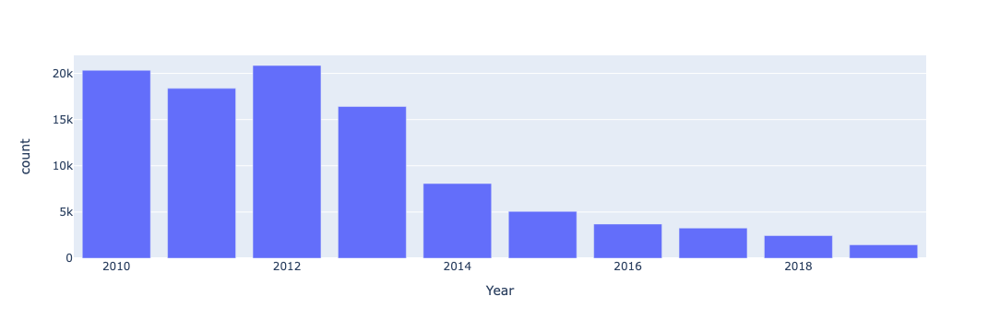

In [27]:
#created a plot using plotly. 
fig = px.bar(arrests_grouped,
       x='Year',
       y='count')

fig.show()

This plot led us to find that there was a significant decline in these types of arrests after 2012, continuing through 2019.

DATA NOTE: we did look into the most recent data for 2020 to present date to ensure the data is not compromised and found that these types of arrests are still down. We also spoke with an employee at Inclusive Action (a nonprofit that works with vendors in LA) and they noted that the Streets Deparement started issuing citation (in place of LAPD) for street vending specifically. This does not account for the decline in public drinking tickets but it does explain some of the trend.

### Looked at the data by arrest type

In [30]:
#grouped the data by charge description to see which type was most common.
arrests_grouped_2 = arrest_df.value_counts(['chrg_desc']).reset_index(name='count')

In [31]:
#printed the output to check the information
arrests_grouped_2

,chrg_desc,count
0,DRINKING IN PUBLIC,93916
1,ILLEGAL STREET/SIDEWALK SALES,4228
2,OPEN ALCOHOLIC BEV IN PUBLIC PARK/PLACE,1848
3,ILLEGAL SALES - FREEWAY RAMPS,6
4,IMPEDING NORMAL FLOW OF TRAFFIC,2


This revealed that the vast majority of the arrests were for drinking in public, followed by street vending citations.

# PART 2 – Neighbrohood Level Arrest Data

This sections explores a subset of the arrest data including information for the six neighborhoods of interest

We selected neighborhoods in three different categories (as categorized by the Urban Displacement Project):
1) At Risk – Low Income/ Susceptible to Displacement (Lincoln Heights, Jefferson Park)
2) Gentrifying – High Displacement Risk (Boyle Heights, Westlake)
3) Exclusionary – Stable Moderate/Mixed Income (Fairfax, Los Feliz)

First, created lists of all the LAPD reporting districts for each neighborhood.

First created a list of all the reporting districts in each neighborhood (those are hidden below).

In [32]:
lincoln_heights_rd = ['0423', 
                      '0424', 
                      '0422', 
                      '0415', 
                      '0417', 
                      '0416', 
                      '0414', 
                      '0413', 
                      '0412', 
                      '0401', 
                      '0402',
                      '0403', 
                      '0407']


In [33]:
fairfax_rd = ['0701',
              '0711',
              '0722',
              '0723',
              '0732',
              '0702',
              '0713',
              '0724',
              '0734',
              '0733',
              '0735',
              '0736',
              '0725',
              '0726',
              '0714',
              '0715',
              '0705',
              '0706',
              '0717',
              '0727',
              '0737',
              '0738',
              '0739',
              '0729',
              '0719']



In [34]:
boyle_heights_rd = ['0449',
                    '0455',
                    '0453',
                    '0452',
                    '0454',
                    '0463',
                    '0464',
                    '0462',
                    '0437',
                    '0456',
                    '0457',
                    '0466',
                    '0467',
                    '0477',
                    '0487',
                    '0489',
                    '0497',
                    '0499',
                    '0479',
                    '0459',
                    '0469',
                    '0478',
                    '0488',
                    '0459',
                    '0448',
                    '0468',
                    '0465']


In [35]:
los_feliz_rd = ['1153',
                '1141',
                '1151',
                '1161',
                '1163',
                '1162',
                '1142',
                '1152',
                '1143',
                '1132',
                '1122',
                '1144',
                '1171']


In [36]:
jefferson_park_rd = ['0309',
                     '0319',
                     '0329',
                     '0308',
                     '0318',
                     '0327',
                     '0325',
                     '0338',
                     '0317',
                     '0337',
                     '0326',
                     '0316',
                     '0336',
                     '0316',
                     '0315',
                     '0335',
                     '0314',
                     '0313',
                     '0334',
                     '0333',
                     '0307',
                     '0305',
                     '0332',
                     '0331']


In [37]:
westlake_rd = ['0231',
               '0233',
               '0235',
               '0236',
               '0237',
               '0241',
               '0238',
               '0251',
               '0245',
               '0239',
               '0246',
               '0247',
               '0248',
               '0261',
               '0257',
               '0256',
               '0271',
               '0265',
               '0266',
               '0275',
               '0269',
               '0281',
               '0279',
               '0285',
               '0289',
               '0291',
               '0295',
               '0299',
               '0291']


### Created a new neighborhood column and labled the neighborhoods based on the reporting district column in the data.

Using the df.loc command added a neighborhood column to the data and filled it in with the correct neighborhood for each row based on the reporting district lists created above.

In [38]:
arrest_df.loc[arrest_df['rd'].isin(lincoln_heights_rd), 'neighborhood'] = 'Lincoln Heights'
arrest_df.loc[arrest_df['rd'].isin(boyle_heights_rd), 'neighborhood'] = 'Boyle Heights'
arrest_df.loc[arrest_df['rd'].isin(fairfax_rd), 'neighborhood'] = 'Fairfax'
arrest_df.loc[arrest_df['rd'].isin(westlake_rd), 'neighborhood'] = 'Westlake'
arrest_df.loc[arrest_df['rd'].isin(jefferson_park_rd), 'neighborhood'] = 'Jefferson Park'
arrest_df.loc[arrest_df['rd'].isin(los_feliz_rd), 'neighborhood'] = 'Los Feliz'

In [39]:
#counted the number of arrests by neighborhood
arrest_df['neighborhood'].value_counts()

Westlake           7117
Jefferson Park     2370
Los Feliz          1666
Boyle Heights      1527
Lincoln Heights     746
Fairfax             720
Name: neighborhood, dtype: int64

### Created a dataframe that just included the rows that are in the three neighborhoods of interest

Next created a new dataframe that just included arrests in the neighborhoods we are studying by creating a list of all the neighborhoods and then defining a new dataframe called arrests_df_nh that just keeps all the records where the neighorhood is defined to be one of the six we are studying. 

In [40]:
#created list of our neighborhoods by name
nh = ['Lincoln Heights', 'Boyle Heights', 'Fairfax', 'Westlake', 'Jefferson Park', 'Los Feliz']

In [43]:
#defined a new dataframe keeping just the rows for those neighbrorhoods
arrest_df_nh = arrest_df.loc[arrest_df['neighborhood'].isin(nh)]

In [44]:
#counted arrests by neighborhood
arrest_df_nh['neighborhood'].value_counts()

Westlake           7117
Jefferson Park     2370
Los Feliz          1666
Boyle Heights      1527
Lincoln Heights     746
Fairfax             720
Name: neighborhood, dtype: int64

In [47]:
#sampled the data to ensure the neighborhood category is defined for the data in this new dataframe
arrest_df_nh.sample(2)

,arst_date,rd,chrg_desc,location_1,lat,lon,Year,neighborhood
17243,2011-11-12,0338,DRINKING IN PUBLIC,"{'type': 'Point', 'coordinates': [-118.2896, 3...",34.0268,-118.2896,2011,Jefferson Park
75969,2015-03-07,0245,DRINKING IN PUBLIC,"{'type': 'Point', 'coordinates': [-118.2738, 3...",34.0613,-118.2738,2015,Westlake


### Grouped the data by year and neighborhood

In [49]:
#created a new dataframe that grouped the data by neighborhood and year
arrests_grouped = arrest_df_nh.value_counts(['neighborhood','Year']).reset_index(name='count')

In [50]:
#printed a sample of 5 to ensure the data was structued properly
arrests_grouped.sample(5)

,neighborhood,Year,count
7,Westlake,2018,400
6,Westlake,2011,431
10,Jefferson Park,2013,356
40,Los Feliz,2015,53
18,Westlake,2016,290


### Charted the arrest data by year and neighborhood

In [51]:
#created a list of colors for the function to use to randomize the colors of the bar charts
import random
colors = px.colors.qualitative.Prism

#created a function to call that will graph the data by year for our three different neighborhood types
def show_arrests_by_neighborhood(arrests_grouped, max_y=None, colors=None, title=None):
    if max_y is not None: #added an option to set the y-axis max (so that it would be consistent across all charts so they are comparable)
        yaxis_range = [0, max_y]
    else:
        yaxis_range = None

    random_colors = random.sample(colors, len(arrests_grouped['neighborhood'].unique())) #randomized the colors using the colors list I created above

#createda figure that charts the data by year and neighborhood

    fig = px.bar(
        arrests_grouped,
        x='Year',
        y='count', 
        color='neighborhood',
        color_discrete_sequence=random_colors
    )
    fig.update_layout(
        yaxis_range=yaxis_range,
        title=title
    )
    fig.show()

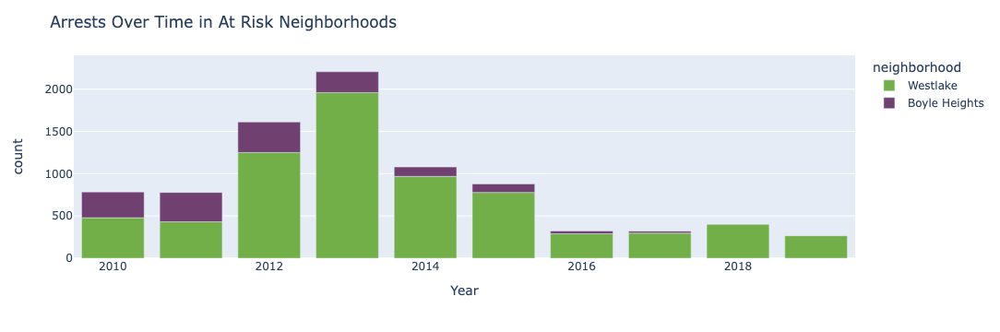

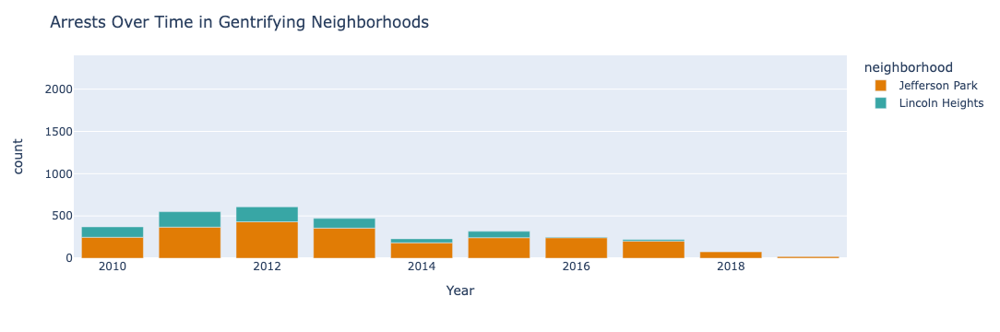

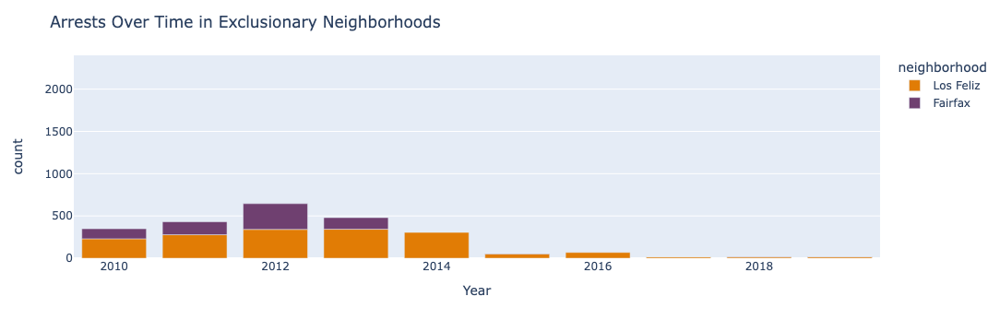

In [52]:
#used the defined functions to creat 3 charts for each of our groups of neighborhood types 
show_arrests_by_neighborhood(arrests_grouped.loc[arrests_grouped['neighborhood'].isin(['Westlake','Boyle Heights'])], max_y=2400, colors=colors, title='Arrests Over Time in At Risk Neighborhoods')
show_arrests_by_neighborhood(arrests_grouped.loc[arrests_grouped['neighborhood'].isin(['Lincoln Heights','Jefferson Park'])], max_y=2400, colors=colors, title='Arrests Over Time in Gentrifying Neighborhoods')
show_arrests_by_neighborhood(arrests_grouped.loc[arrests_grouped['neighborhood'].isin(['Los Feliz','Fairfax'])], max_y=2400, colors=colors, title='Arrests Over Time in Exclusionary Neighborhoods')


Similarly to the citywide data, here we see that this type of arrest become much less common after 2012. As we hypothesized, these types of arrests were more frequent in the at risk neighborhoods than the gentrifying and exclusionary neighborhoods.

# PART 3 – Mapped the arrest types in our neighborhoods

In [53]:
#renamed the charge description data so the map was more legible
arrest_df_nh.rename(columns={'chrg_desc': 'Charge Description'}, inplace=True)

/tmp/ipykernel_3025/3330390298.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [54]:
#checked the data types and change the lat long variables into floats so they could be mapped
arrest_df_nh.dtypes

arst_date             datetime64[ns]
rd                            object
Charge Description            object
location_1                    object
lat                           object
lon                           object
Year                           int64
neighborhood                  object
dtype: object

In [55]:
arrest_df_nh['lat'] = arrest_df_nh['lat'].astype(float)
arrest_df_nh['lon'] = arrest_df_nh['lon'].astype(float)

/tmp/ipykernel_3025/3736439519.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_3025/3736439519.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Used plotly to map the arrests by type, as we found above the most common type was drinking in public in Westlake. This also shows that almost all of the vending citations were issued in westlake.

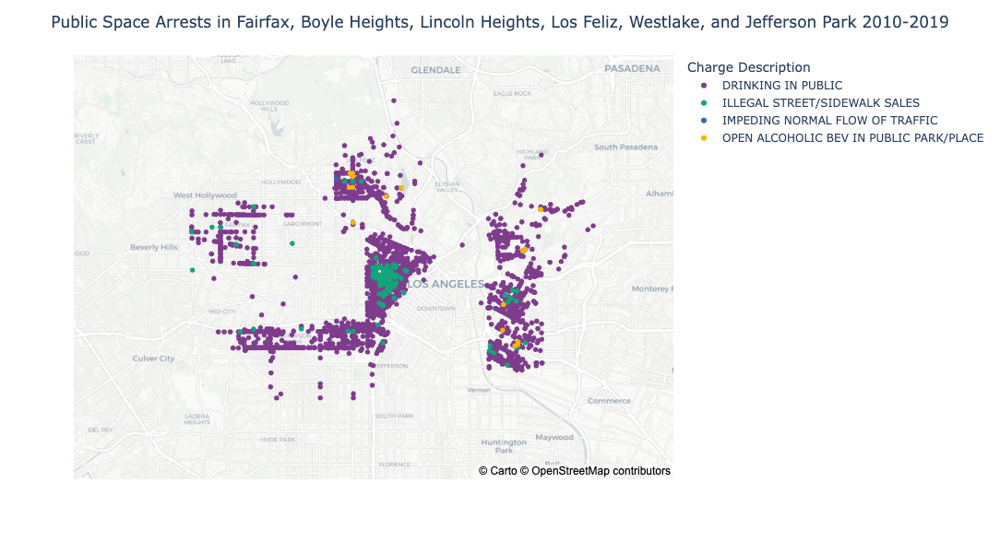

In [56]:
fig = px.scatter_mapbox(arrest_df_nh,
                        lat='lat',
                        lon='lon',
                        zoom=10.5,
                        color='Charge Description',
                        hover_data=['Year','neighborhood'],
                        mapbox_style="carto-positron",
                        color_discrete_sequence = px.colors.qualitative.Bold,
                        center=dict(
                            lat=34.060695018239,
                            lon=-118.28083936452524)
                       )

fig.update_layout(
    width = 1000,
    height = 600,
    title = "Public Space Arrests in Fairfax, Boyle Heights, Lincoln Heights, Los Feliz, Westlake, and Jefferson Park 2010-2019",
    title_x=0.5
    
)

fig.show()

### Overlayed the arrest data with parks and open space

In [57]:
#imported the geojson file for parks in Los Angeles

parks_df = gpd.read_file('Recreation_and_Parks.geojson')
parks_df.sample(5)

ERROR 1: PROJ: proj_create_from_database: Open of /opt/conda/share/proj failed


,OBJECTID,Area_Acres,Park_ID,CD_Real,Address,Region,Name,Park_Class,CD_NEW,TOOLTIP,ACRES,geometry
4,5,0.960725,213,09,4800 S. Hoover St,P,Julian C. Dixon Park,N,9,Name: Julian C. Dixon Park\nLocation: 4800 S. ...,0.96072542,"POLYGON ((-118.28680 33.99881, -118.28664 33.9..."
371,372,138.773129,272,04,4730 Crystal Springs Dr,G,Harding Golf Course,R,4,Name: Harding Golf Course\nLocation: 4730 Crys...,138.7731292,"POLYGON ((-118.28452 34.14700, -118.28451 34.1..."
160,161,29.868771,727,01,2230 W 6th Street,M,MacArthur Park,C,1,Name: MacArthur Park\nLocation: 2230 W 6th Street,29.86877092,"MULTIPOLYGON (((-118.27607 34.05789, -118.2760..."
251,252,7.813606,375,08,5720 2nd Avenue,P,Van Ness Recreation Center,N,8,Name: Van Ness Recreation Center\nLocation: 57...,7.81360616,"POLYGON ((-118.31763 33.99101, -118.31915 33.9..."
323,324,149.535958,225,12,8751-9461 Valley Circle Blvd,V,Chatsworth Reservoir Site,R,12,Name: Chatsworth Reservoir Site\nLocation: 875...,149.53595831,"MULTIPOLYGON (((-118.64473 34.23692, -118.6447..."


In [58]:
import geopandas as gpd
from shapely.geometry import Polygon

#removed all the single Multipoligons and turned them into single polygons
park_df = parks_df.explode(column='geometry', ignore_index=False, index_parts=None)
park_df.sample(5)

/tmp/ipykernel_3025/2780584960.py:5: FutureWarning:

Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.



,,OBJECTID,Area_Acres,Park_ID,CD_Real,Address,Region,Name,Park_Class,CD_NEW,TOOLTIP,ACRES,geometry
106,1,107,0.489790,298,04,HILLHURST AVE. BTWN. LOS FELIZ BLVD. & VERMONT...,G,Hillhurst Parkway,N,4,Name: Hillhurst Parkway\nLocation: HILLHURST A...,0.48978951,"POLYGON ((-118.28744 34.11206, -118.28743 34.1..."
222,0,223,5.453888,301,04,3191 W 4th St,M,Shatto Recreation Center,N,13,Name: Shatto Recreation Center\nLocation: 3191...,5.45388787,"POLYGON ((-118.28920 34.06811, -118.28920 34.0..."
403,0,404,40.073993,321,15,3800 Stephen M. White Drive,P,Cabrillo Beach,C,15,Name: Cabrillo Beach\nLocation: 3800 Stephen M...,40.07399335,"POLYGON ((-118.28382 33.71351, -118.28378 33.7..."
93,0,94,4.820433,142,11,4601 Alla Rd,W,Glen Alla Park,N,11,Name: Glen Alla Park\nLocation: 4601 Alla Rd,4.82043253,"POLYGON ((-118.43051 33.98381, -118.43124 33.9..."
112,0,113,3.660080,345,02,7747 Foothill Blvd,V,Howard Finn Park,N,7,Name: Howard Finn Park\nLocation: 7747 Foothil...,3.66007985,"POLYGON ((-118.29992 34.25876, -118.29993 34.2..."


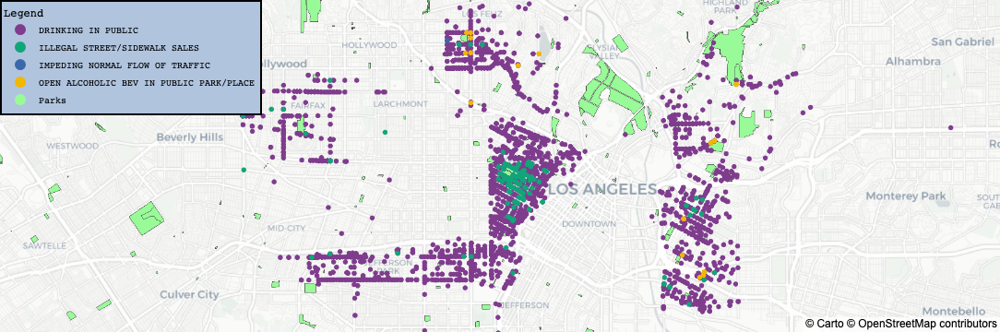

In [59]:
fig = px.scatter_mapbox(arrest_df_nh,
                        lat='lat',
                        lon='lon',
                        zoom=11,
                        color='Charge Description',
                        hover_data=['Year','neighborhood'],
                        mapbox_style="carto-positron",
                        color_discrete_sequence = px.colors.qualitative.Bold,
                        center=dict(
                            lat=34.060695018239,
                            lon=-118.28083936452524)
                       )


fig.update_layout(
    mapbox = {
        'layers': [
                {
                    "name": "Parks",
                    "source": json.loads(parks_df.geometry.to_json()),
                    "type": "fill",
                    "below": "traces",
                    "color": "palegreen"
                }
            ],
        },
    legend=dict(
        title="Legend", 
        itemsizing='constant',
        x=0,
        y=1,
        font=dict(
            family="Courier",
            size=10,
            color="black"
        ),
        bgcolor="LightSteelBlue",
        bordercolor="Black",
        borderwidth=2
    ),
    margin = {'l':0, 'r':0, 'b':0, 't':0}
)

# Add a new trace with a marker for the Parks layer
fig.add_trace(go.Scattermapbox(
    name="Parks",
    mode='markers',
    lon=[0],
    lat=[0],
    hoverinfo="none",
    marker=dict(
        color='palegreen',
        size=10,
        symbol='circle'
    ),
    showlegend=True  # show the trace in the legend
))

fig.show()